## Clustering using TF-IDF Vectorization(with Lemmatization) with MiniBatchKMeans

In this notebook, we will use Lemmatizer to lemmatize the words in the sentence. We will also use TF-IDF Vectorization and MiniBatchKMeans clustering technique.

To judge the clustering technique, We will use `Silhouette Coefficient` as we are not having labels to judge the clustering model.

We will also use LSA ([Latent Semantic Analysis](https://en.wikipedia.org/wiki/Latent_semantic_analysis)) for dimensionality reduction.

#### Import necessary libraries

In [1]:
from pathlib import Path
from time import time
from collections import defaultdict

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

from sklearn.cluster import MiniBatchKMeans
from sklearn import metrics
from sklearn.decomposition import PCA 
import seaborn as sns
import matplotlib.pyplot as plt

# fit_and_evaluate take the MiniBatchKMeans model and dataset
# And showcase the metrices value (like Silhouette score)
from utils import fit_and_evaluate

### Loading preprocessed_dataset

In [2]:
dataset_path = Path("../dataset/preprocessed_data.csv")
dataset = pd.read_csv(dataset_path, encoding="utf-8")
# fill null values by None keyword
dataset.fillna("NaN", inplace=True)
dataset.head()

,Text
0,moeller student-run newspaper crusader consist...
1,crusader first place second-highest honor high...
2,squire student literary journal features stori...
3,paul keels - play-by-play announcer ohio state...
4,joe uecker - ohio state senator


In [3]:
dataset.isnull().sum()

Text    0
dtype: int64

### Lemmatize the dataset

In [4]:
# Stemmer is fast but not getting actual root words
# So, we will use Lemmatization
import nltk
nltk.download("wordnet")
nltk.download('omw-1.4')
from nltk.stem import WordNetLemmatizer

def lemmatizer(sentence):
    """
    this method lemmatize the sentence and return sentence containing root of the words (actual word unlike Stemmer)
    """
    wnl = WordNetLemmatizer()

    new_sentence =" ".join([wnl.lemmatize(word) for word in sentence.split(" ")])

    return new_sentence

lemmatizer("how many cats are sitting on the beds availabel there?")
# available is intentionally made as typos
# So, It will be as it is.

[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\modassir\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package omw-1.4 to
[nltk_data]     C:\Users\modassir\AppData\Roaming\nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!


'how many cat are sitting on the bed availabel there?'

In [5]:
t0 = time()
dataset["Text"] = dataset["Text"].apply(lemmatizer)
dataset.head()
print(f"time taken to lemmatize the dataset: {time() - t0}")

time taken to lemmatize the dataset: 3.4238290786743164


### Feature Extraction using TfidfVectorizer

In [6]:
# fill NaN values
dataset = dataset.fillna("None")

In [7]:
from sklearn.feature_extraction.text import TfidfVectorizer

vectorizer = TfidfVectorizer(
    # if the word is present in more than 80% of documents, will not be considered
    max_df=0.8,
    # minimum number of docs which consists particular word
    min_df=5,
    stop_words="english",
    ngram_range=(1,3),
    use_idf=True,
)

t0 = time()
X_tfidf = vectorizer.fit_transform(dataset["Text"])

print(f"vectorization done in {time() - t0:.5f} s")
print(f"n_samples: {X_tfidf.shape[0]}, n_features: {X_tfidf.shape[1]}")

vectorization done in 2.85101 s
n_samples: 46117, n_features: 18046


There are approx `18K` features. which is huge

Let's see the Sparsity

#### Sparsity

In [8]:
print(f"The sparsity is: {X_tfidf.nnz/np.prod(X_tfidf.shape):.3f}")

The sparsity is: 0.001


We find that around `0.1%` of the entries of the `X_tfidf` matrix are non-zero.

### Reducing the no.of dimension using LSA

ref: [See LSA in detail!](https://en.wikipedia.org/wiki/Latent_semantic_analysis)

In [9]:
from sklearn.decomposition import TruncatedSVD
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import Normalizer

# As TruncatedSVD result is not Normalized, we'll Normalize the result also
lsa = make_pipeline(TruncatedSVD(n_components=100), Normalizer(copy=False))
t0 = time()
X_lsa = lsa.fit_transform(X_tfidf)
explained_variance = lsa[0].explained_variance_ratio_.sum()
print(f"LSA done in {time() - t0:.3f} s")
print(f"Explained variance of the SVD step: {explained_variance * 100:.1f}%")

LSA done in 2.637 s
Explained variance of the SVD step: 8.3%


### Visualize the data in 3D

In [10]:
# !pip install cufflinks plotly

In [11]:
# to visualize high-dimensional data into lower-dimension(2D)
import plotly.express as px
def visualize_data_3d(X, labels=None, path=None)->None:
    """
    this method takes high-dimensional data and change it into lower-dimension
    using PCA. (3D)
    """
    pca = PCA(n_components=3, svd_solver="auto")
    components = pca.fit_transform(X)
    total_var = pca.explained_variance_ratio_.sum()*100
    
    X_pca = pd.DataFrame({"0":components[:,0], "1":components[:,1], "2": components[:,2]})
    
    fig = px.scatter_3d(
        components, x=0, y=1, z=2, color=labels,
        title=f"Total Explained Variance: {total_var:.2f}%",
        labels={'0': 'PC 1', '1': 'PC 2', '2': 'PC 3'},
    )
    if path is not None:
        fig.write_html(path)
    fig.show()

In [12]:
visualize_data_3d(X_lsa)

### Clustering with MiniBatchKMeans

#### finding K(n_clusters) value using Elbow method

Just Visualizing the data with reduced no.of features can't always give the best result.
So, we will find the value of `K` by using Elbow method.

There are two things to understand
1. __Distortion__: it is calculated as the average of the squared distance from the cluster centers of the respective clusters. Typically, the __Euclidean distance__ metric is used.
2. __Inertia__: it is the sum of squared distances of samples of their closest cluster center.

##### Building the clustering model and calculating the values of the `Distortion` and `Inertia`:

In [13]:
from sklearn import metrics
from scipy.spatial.distance import cdist
from typing import List
  
def getting_distortion_and_inertia(X, K:List[int]):
    distortions = []
    inertias = []
    mapping1 = {}
    mapping2 = {}
    count=1
    for k in K:
        t0 = time()
        # Building and fitting the model
        kmeans_model = MiniBatchKMeans(n_clusters=k).fit(X)
        kmeans_model.fit(X)
    
        distortions.append(sum(np.min(cdist(X, kmeans_model.cluster_centers_,
                                            'euclidean'), axis=1)) / X.shape[0])
        inertias.append(kmeans_model.inertia_)
    
        mapping1[k] = sum(np.min(cdist(X, kmeans_model.cluster_centers_,
                                    'euclidean'), axis=1)) / X.shape[0]
        mapping2[k] = kmeans_model.inertia_

        print(f"Time taken in iteration {count} = {time()-t0}")
        count+=1

    return (
        distortions,
        inertias,
        mapping1,
        mapping2,
    )
    

In [14]:
list_of_cluster_size = range(1,300)
distortions, inertias, mapping1, mapping2 = getting_distortion_and_inertia(X_lsa, list_of_cluster_size)

Time taken in iteration 1 = 0.21224021911621094
Time taken in iteration 2 = 0.22708988189697266
Time taken in iteration 3 = 0.26599597930908203
Time taken in iteration 4 = 0.24477672576904297
Time taken in iteration 5 = 0.24447393417358398
Time taken in iteration 6 = 0.2915616035461426
Time taken in iteration 7 = 0.2939000129699707
Time taken in iteration 8 = 0.25659799575805664
Time taken in iteration 9 = 0.3409421443939209
Time taken in iteration 10 = 0.42706775665283203
Time taken in iteration 11 = 0.3100707530975342
Time taken in iteration 12 = 0.3166928291320801
Time taken in iteration 13 = 0.35726404190063477
Time taken in iteration 14 = 0.412369966506958
Time taken in iteration 15 = 0.3561382293701172
Time taken in iteration 16 = 0.39983034133911133
Time taken in iteration 17 = 0.450808048248291
Time taken in iteration 18 = 0.4149327278137207
Time taken in iteration 19 = 0.4030756950378418
Time taken in iteration 20 = 0.4231901168823242
Time taken in iteration 21 = 0.42487764358

Time taken in iteration 172 = 1.8658149242401123
Time taken in iteration 173 = 1.9768791198730469
Time taken in iteration 174 = 1.802314043045044
Time taken in iteration 175 = 2.050741672515869
Time taken in iteration 176 = 2.2377655506134033
Time taken in iteration 177 = 2.162332534790039
Time taken in iteration 178 = 2.2012972831726074
Time taken in iteration 179 = 2.354428768157959
Time taken in iteration 180 = 1.9874820709228516
Time taken in iteration 181 = 3.3182573318481445
Time taken in iteration 182 = 2.1882834434509277
Time taken in iteration 183 = 2.1761436462402344
Time taken in iteration 184 = 1.9512763023376465
Time taken in iteration 185 = 2.9265658855438232
Time taken in iteration 186 = 2.418578863143921
Time taken in iteration 187 = 2.4155526161193848
Time taken in iteration 188 = 2.120022773742676
Time taken in iteration 189 = 2.075106143951416
Time taken in iteration 190 = 2.2327568531036377
Time taken in iteration 191 = 2.6990880966186523
Time taken in iteration 192

#### Tabulating and Visualizing the results

##### Using the different values of distortions

In [15]:
# for key, value in mapping1.items():
#     print(f"{key}: {value}")

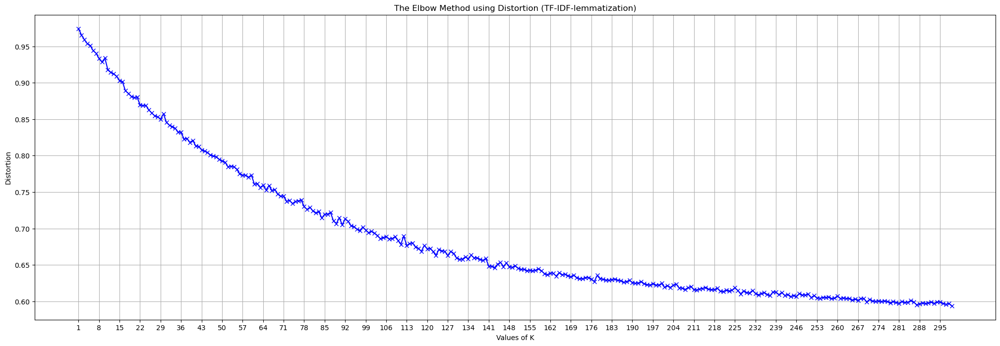

In [19]:
# plotting distortions
plt.figure(figsize=(25,8))
plt.plot(list_of_cluster_size, distortions, 'bx-')
plt.xlabel('Values of K')
plt.xticks(list_of_cluster_size[::7])
plt.ylabel('Distortion')
plt.title('The Elbow Method using Distortion (TF-IDF-lemmatization)')
plt.grid()
plt.show()

##### Using the different values of Inertia

In [20]:
# for key, value in mapping2.items():
#     print(f"{key}: {value}")

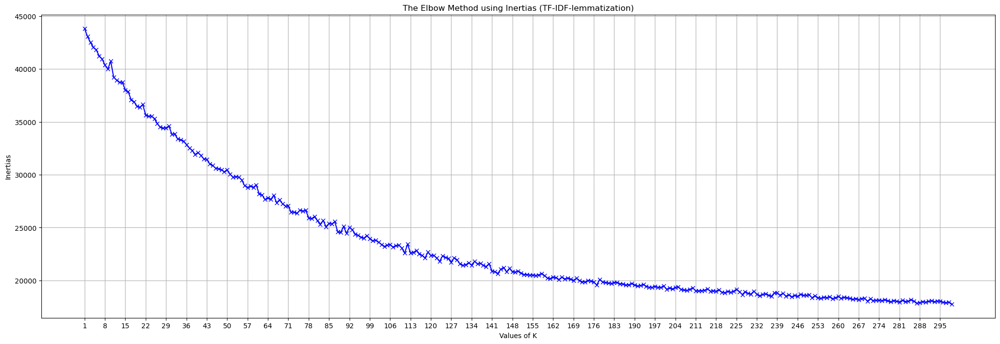

In [21]:
# plotting distortions 
plt.figure(figsize=(25,8))
plt.plot(list_of_cluster_size, inertias, 'bx-')
plt.xlabel('Values of K')
plt.xticks(list_of_cluster_size[::7])
plt.ylabel('Inertias')
plt.title('The Elbow Method using Inertias (TF-IDF-lemmatization)')
plt.grid()
plt.show()

__Summary__: 
- There is no abrupt changes in the Inertia or distortions. So, It is very hard to get the value of K using Elbow method

### Let's evaluate model on different `n_clusters` value using `Silhouette coefficient`

In [14]:
count=1
scores = {} # dict to store the results for each 
for i in range(2,300):
    print(f"------ iteration : {count} , n_clusters: {i}------")
    kmeans = MiniBatchKMeans(
        n_clusters=i,
        max_iter=100,
        n_init=10,
    )
    score_dict = fit_and_evaluate(kmeans,X_lsa)
    scores[i] = score_dict
    count+=1
    print()

------ iteration : 1 , n_clusters: 2------
Clustering done in 0.20 ± 0.13 s
Silhouette Coefficient: 0.015 ± 0.001
Calinski-Harabasz Index: 853.507 ± 132.467
Davies-Bouldin Index: 6.968 ± 0.863

------ iteration : 2 , n_clusters: 3------
Clustering done in 0.10 ± 0.01 s
Silhouette Coefficient: 0.014 ± 0.004
Calinski-Harabasz Index: 617.215 ± 146.064
Davies-Bouldin Index: 6.537 ± 1.908

------ iteration : 3 , n_clusters: 4------
Clustering done in 0.16 ± 0.05 s
Silhouette Coefficient: 0.017 ± 0.002
Calinski-Harabasz Index: 617.910 ± 77.321
Davies-Bouldin Index: 5.470 ± 1.490

------ iteration : 4 , n_clusters: 5------
Clustering done in 0.13 ± 0.02 s
Silhouette Coefficient: 0.020 ± 0.001
Calinski-Harabasz Index: 585.978 ± 21.052
Davies-Bouldin Index: 6.356 ± 0.087

------ iteration : 5 , n_clusters: 6------
Clustering done in 0.13 ± 0.03 s
Silhouette Coefficient: 0.012 ± 0.023
Calinski-Harabasz Index: 486.782 ± 185.574
Davies-Bouldin Index: 5.186 ± 1.269

------ iteration : 6 , n_cluster

Clustering done in 0.30 ± 0.01 s
Silhouette Coefficient: 0.100 ± 0.004
Calinski-Harabasz Index: 436.008 ± 6.993
Davies-Bouldin Index: 2.875 ± 0.068

------ iteration : 44 , n_clusters: 45------
Clustering done in 0.29 ± 0.02 s
Silhouette Coefficient: 0.101 ± 0.003
Calinski-Harabasz Index: 434.155 ± 7.859
Davies-Bouldin Index: 2.807 ± 0.074

------ iteration : 45 , n_clusters: 46------
Clustering done in 0.31 ± 0.02 s
Silhouette Coefficient: 0.095 ± 0.004
Calinski-Harabasz Index: 423.885 ± 9.879
Davies-Bouldin Index: 2.720 ± 0.022

------ iteration : 46 , n_clusters: 47------
Clustering done in 0.31 ± 0.02 s
Silhouette Coefficient: 0.103 ± 0.006
Calinski-Harabasz Index: 432.454 ± 5.556
Davies-Bouldin Index: 2.731 ± 0.089

------ iteration : 47 , n_clusters: 48------
Clustering done in 0.31 ± 0.02 s
Silhouette Coefficient: 0.100 ± 0.009
Calinski-Harabasz Index: 428.083 ± 17.919
Davies-Bouldin Index: 2.696 ± 0.072

------ iteration : 48 , n_clusters: 49------
Clustering done in 0.30 ± 0.0

Clustering done in 0.50 ± 0.02 s
Silhouette Coefficient: 0.142 ± 0.007
Calinski-Harabasz Index: 399.831 ± 6.989
Davies-Bouldin Index: 2.430 ± 0.066

------ iteration : 87 , n_clusters: 88------
Clustering done in 0.47 ± 0.02 s
Silhouette Coefficient: 0.140 ± 0.004
Calinski-Harabasz Index: 398.424 ± 5.655
Davies-Bouldin Index: 2.421 ± 0.055

------ iteration : 88 , n_clusters: 89------
Clustering done in 0.51 ± 0.02 s
Silhouette Coefficient: 0.140 ± 0.007
Calinski-Harabasz Index: 395.916 ± 9.708
Davies-Bouldin Index: 2.437 ± 0.054

------ iteration : 89 , n_clusters: 90------
Clustering done in 0.51 ± 0.02 s
Silhouette Coefficient: 0.144 ± 0.007
Calinski-Harabasz Index: 400.390 ± 3.418
Davies-Bouldin Index: 2.403 ± 0.065

------ iteration : 90 , n_clusters: 91------
Clustering done in 0.54 ± 0.04 s
Silhouette Coefficient: 0.138 ± 0.007
Calinski-Harabasz Index: 394.850 ± 5.979
Davies-Bouldin Index: 2.405 ± 0.038

------ iteration : 91 , n_clusters: 92------
Clustering done in 0.51 ± 0.02

Clustering done in 0.72 ± 0.06 s
Silhouette Coefficient: 0.150 ± 0.007
Calinski-Harabasz Index: 361.131 ± 8.217
Davies-Bouldin Index: 2.295 ± 0.080

------ iteration : 129 , n_clusters: 130------
Clustering done in 0.73 ± 0.03 s
Silhouette Coefficient: 0.158 ± 0.004
Calinski-Harabasz Index: 365.232 ± 3.456
Davies-Bouldin Index: 2.243 ± 0.040

------ iteration : 130 , n_clusters: 131------
Clustering done in 0.70 ± 0.03 s
Silhouette Coefficient: 0.156 ± 0.005
Calinski-Harabasz Index: 364.192 ± 3.983
Davies-Bouldin Index: 2.274 ± 0.046

------ iteration : 131 , n_clusters: 132------
Clustering done in 0.70 ± 0.03 s
Silhouette Coefficient: 0.156 ± 0.007
Calinski-Harabasz Index: 361.240 ± 4.463
Davies-Bouldin Index: 2.304 ± 0.037

------ iteration : 132 , n_clusters: 133------
Clustering done in 0.72 ± 0.04 s
Silhouette Coefficient: 0.158 ± 0.008
Calinski-Harabasz Index: 359.467 ± 4.157
Davies-Bouldin Index: 2.288 ± 0.037

------ iteration : 133 , n_clusters: 134------
Clustering done in 0

Clustering done in 0.87 ± 0.02 s
Silhouette Coefficient: 0.155 ± 0.008
Calinski-Harabasz Index: 323.726 ± 2.526
Davies-Bouldin Index: 2.209 ± 0.049

------ iteration : 171 , n_clusters: 172------
Clustering done in 0.90 ± 0.04 s
Silhouette Coefficient: 0.153 ± 0.012
Calinski-Harabasz Index: 322.611 ± 3.965
Davies-Bouldin Index: 2.249 ± 0.072

------ iteration : 172 , n_clusters: 173------
Clustering done in 0.93 ± 0.04 s
Silhouette Coefficient: 0.152 ± 0.009
Calinski-Harabasz Index: 321.895 ± 4.234
Davies-Bouldin Index: 2.210 ± 0.035

------ iteration : 173 , n_clusters: 174------
Clustering done in 0.93 ± 0.04 s
Silhouette Coefficient: 0.148 ± 0.005
Calinski-Harabasz Index: 319.714 ± 2.904
Davies-Bouldin Index: 2.263 ± 0.041

------ iteration : 174 , n_clusters: 175------
Clustering done in 0.95 ± 0.05 s
Silhouette Coefficient: 0.152 ± 0.005
Calinski-Harabasz Index: 318.464 ± 3.554
Davies-Bouldin Index: 2.260 ± 0.061

------ iteration : 175 , n_clusters: 176------
Clustering done in 0

Clustering done in 1.16 ± 0.04 s
Silhouette Coefficient: 0.143 ± 0.005
Calinski-Harabasz Index: 283.397 ± 1.782
Davies-Bouldin Index: 2.252 ± 0.039

------ iteration : 213 , n_clusters: 214------
Clustering done in 1.18 ± 0.07 s
Silhouette Coefficient: 0.146 ± 0.005
Calinski-Harabasz Index: 281.822 ± 1.786
Davies-Bouldin Index: 2.259 ± 0.064

------ iteration : 214 , n_clusters: 215------
Clustering done in 1.22 ± 0.05 s
Silhouette Coefficient: 0.146 ± 0.003
Calinski-Harabasz Index: 283.563 ± 2.702
Davies-Bouldin Index: 2.248 ± 0.056

------ iteration : 215 , n_clusters: 216------
Clustering done in 1.15 ± 0.03 s
Silhouette Coefficient: 0.144 ± 0.010
Calinski-Harabasz Index: 279.138 ± 2.925
Davies-Bouldin Index: 2.294 ± 0.054

------ iteration : 216 , n_clusters: 217------
Clustering done in 1.14 ± 0.06 s
Silhouette Coefficient: 0.145 ± 0.006
Calinski-Harabasz Index: 280.064 ± 3.874
Davies-Bouldin Index: 2.236 ± 0.055

------ iteration : 217 , n_clusters: 218------
Clustering done in 1

Clustering done in 1.35 ± 0.13 s
Silhouette Coefficient: 0.143 ± 0.006
Calinski-Harabasz Index: 254.139 ± 1.487
Davies-Bouldin Index: 2.272 ± 0.046

------ iteration : 255 , n_clusters: 256------
Clustering done in 1.32 ± 0.04 s
Silhouette Coefficient: 0.140 ± 0.006
Calinski-Harabasz Index: 250.338 ± 0.986
Davies-Bouldin Index: 2.329 ± 0.039

------ iteration : 256 , n_clusters: 257------
Clustering done in 1.40 ± 0.04 s
Silhouette Coefficient: 0.140 ± 0.007
Calinski-Harabasz Index: 251.226 ± 1.781
Davies-Bouldin Index: 2.277 ± 0.031

------ iteration : 257 , n_clusters: 258------
Clustering done in 1.33 ± 0.06 s
Silhouette Coefficient: 0.136 ± 0.005
Calinski-Harabasz Index: 249.932 ± 1.384
Davies-Bouldin Index: 2.304 ± 0.052

------ iteration : 258 , n_clusters: 259------
Clustering done in 1.40 ± 0.06 s
Silhouette Coefficient: 0.140 ± 0.007
Calinski-Harabasz Index: 249.802 ± 1.323
Davies-Bouldin Index: 2.292 ± 0.036

------ iteration : 259 , n_clusters: 260------
Clustering done in 1

Clustering done in 1.96 ± 0.54 s
Silhouette Coefficient: 0.130 ± 0.015
Calinski-Harabasz Index: 226.690 ± 0.811
Davies-Bouldin Index: 2.358 ± 0.026

------ iteration : 297 , n_clusters: 298------
Clustering done in 1.84 ± 0.21 s
Silhouette Coefficient: 0.130 ± 0.007
Calinski-Harabasz Index: 226.009 ± 0.556
Davies-Bouldin Index: 2.354 ± 0.042

------ iteration : 298 , n_clusters: 299------
Clustering done in 1.62 ± 0.10 s
Silhouette Coefficient: 0.125 ± 0.005
Calinski-Harabasz Index: 224.167 ± 0.829
Davies-Bouldin Index: 2.335 ± 0.013



In [15]:
metrics_result = {}
for item in scores.items():
    key, value = item
    for metric in value:
        if metric not in metrics_result:
            metrics_result[metric] = [np.array(value[metric]).mean()]
        else:
            metrics_result[metric].append(np.array(value[metric]).mean())

In [16]:
len(metrics_result["Silhouette Coefficient"])

298

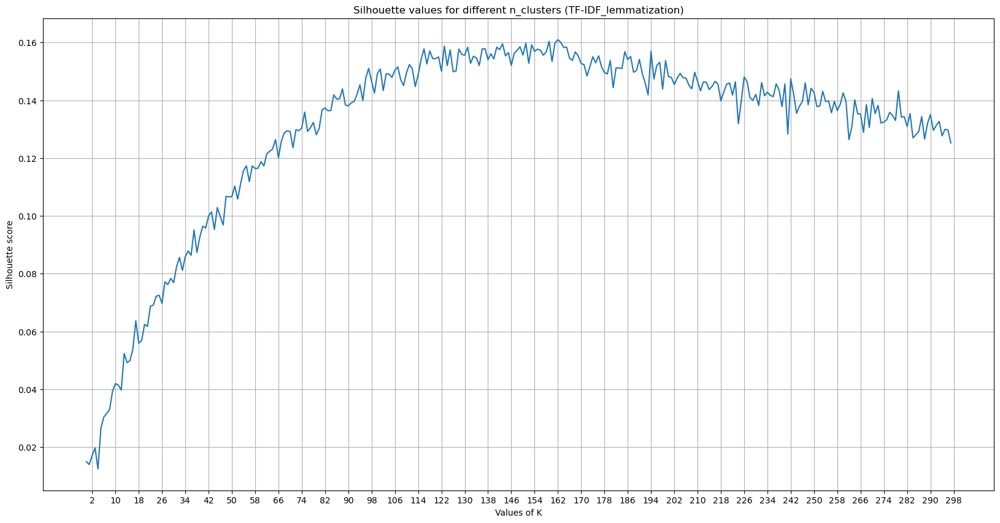

In [19]:
# plotting Silhouette scores
list_of_cluster_size = range(1,300)
plt.figure(figsize=(20,10))
plt.plot(metrics_result['Silhouette Coefficient'])
plt.xlabel('Values of K')
plt.xticks(list_of_cluster_size[1::8])
plt.ylabel('Silhouette score')
plt.title('Silhouette values for different n_clusters (TF-IDF_lemmatization)')
plt.grid()
plt.show()

In [20]:
# get the index of maximum Silhouette score
K = np.argmax(metrics_result['Silhouette Coefficient']) + 2 # added 2 because cluster size is greater 2 than index
K

164

### Let's fit the MiniBatchKMeans model on K=156

In [21]:
from utils import fit_and_evaluate
kmeans = MiniBatchKMeans(
    n_clusters=K,
    max_iter=100,
    n_init=10,
)
fit_and_evaluate(kmeans, X_lsa, n_runs=1)

Clustering done in 3.40 ± 0.00 s
Silhouette Coefficient: 0.161 ± 0.000
Calinski-Harabasz Index: 335.608 ± 0.000
Davies-Bouldin Index: 2.172 ± 0.000


defaultdict(list,
            {'Silhouette Coefficient': [0.1612734705760831],
             'Calinski-Harabasz Index': [335.6078075061401],
             'Davies-Bouldin Index': [2.171536214133671]})

### Top terms per cluster
Since TfidfVectorizer can be inverted we can identify the cluster centers, which provide an intuition of the most influential words for __each cluster__.

In [22]:
original_space_centroids = lsa[0].inverse_transform(kmeans.cluster_centers_)
order_centroids = original_space_centroids.argsort()[:, ::-1]
# .get_feature_names() is deprecated. So, use .get_feature_names_out()
terms = vectorizer.get_feature_names_out()

n_clusters = K #K=30, got 0.125 silhouette score

for i in range(n_clusters):
    print("="*30)
    print(f"Cluster {i}: ", end="")
    for idx in order_centroids[i, :40]:
        print(f"{terms[idx]} ",end=" ")
    print("\n")

Cluster 0: march  team  april  minister  country  nuclear  august  district  public  prime  prime minister  november  released  began  september  power  music  book  album  sport  india  river  played  series  announced  police  act  appearance  high  texas  january  according  line  song  office  later  plant  place  month  civil  

Cluster 1: family  people  census  household  census people  residing  people household  census people household  household family  people household family  family residing  household family residing  residing city  family residing city  city  population  according  state census  united state census  united  united state  line  living  state census people  median  air  village  median income  town  female  total  income  according census  person  british  county  model  march  census bureau  student  

Cluster 2: large  number  small  education  house  river  population  park  high  college  long  industry  built  region  played  form  star  home  produced

    The most important words belonging to cluster seems to be well grouped

#### Make predictions on the X_lsa dataset

We will do fit and predictions using MiniBatchKMeans algo.
- Will see the distribution of cluster size

In [23]:
# doing predictions
predictions = kmeans.predict(X_lsa)

In [24]:
# assigning predicitons to dataset
dataset["label"] = pd.Series(predictions)

In [25]:
dataset.head()

,Text,label
0,moeller student-run newspaper crusader consist...,5
1,crusader first place second-highest honor high...,129
2,squire student literary journal feature story ...,5
3,paul keel - play-by-play announcer ohio state ...,104
4,joe uecker - ohio state senator,9


#### Visualize the prediction in 3D 

In [26]:
visualize_data_3d(X_lsa, dataset.label, "../result/mb_kmeans_tfidf_lemmatized.html")

## Using community_detection algorithm

`sentence_transfomers` has a `community_detection` algorithm that quickly finds local communities of similar sentences in a large list of sentence_embeddings.

It has two hyper-parameters that can be used to control the tightness and minimum size of the clusters: the threshold `t` and minimum community size `k`.


### Working of the algorithm
The algorithm works as follows; 
- it starts by comparing the similarity of all sentences with all other sentences by calculating the pairwise cosine similarities of the sentence embeddings. 
- Then, for each sentence, it selects all other sentences that have a cosine similarity score bigger than the predefined threshold t. 
- It then sorts all sentences by cluster size (i.e. the number of other sentences within the threshold) and keeps the biggest clusters that do not overlap with an existing cluster and have at least k sentences in it.
- The first sentence in each cluster is the most central sentence of that cluster. All other sentences have a cosine similarity of at least t with this sentence.

### NOTE:
<pre>
community_detection algorithm does not ensure that all sentences are clustered.

It will find regions with high density (cosine similarity higher than the threshold). It then returns the center point as cluster node plus all sentences within that region.

If a sentence is now outside of that threshold, it will not be returned. It will also not be part of another cluster if in that area are not sufficient sentences to create a new cluster.
</pre>

<hr>
<pre>
Function for Fast Community Detection

Finds in the embeddings all communities, i.e. embeddings that are close (closer than threshold).

Returns only communities that are larger than min_community_size. The communities are returned
in decreasing order. The first element in each list is the central point in the community.
</pre>

In [ ]:
# !pip install sentence_transformers

In [27]:
from sentence_transformers import util
import torch
t0 = time()
clusters = util.community_detection(
    torch.Tensor(X_lsa),
#     min_community_size=10,
#     threshold=0.50,
)
print(f"time taken to create clusters is: {time()-t0}")

time taken to create clusters is: 272.3875482082367


In [28]:
print(f"There are {len(clusters)} clusters formed") # no.of clusters

There are 742 clusters formed


In [29]:
cluster_count = {} # no.of documents in each cluster
for i, cluster in enumerate(clusters):
    cluster_count[i] = len(cluster)

In [30]:
cluster_count

{0: 406,
 1: 404,
 2: 356,
 3: 346,
 4: 346,
 5: 340,
 6: 327,
 7: 267,
 8: 267,
 9: 266,
 10: 260,
 11: 252,
 12: 251,
 13: 251,
 14: 246,
 15: 246,
 16: 244,
 17: 231,
 18: 221,
 19: 219,
 20: 218,
 21: 214,
 22: 211,
 23: 206,
 24: 204,
 25: 201,
 26: 201,
 27: 198,
 28: 198,
 29: 197,
 30: 195,
 31: 189,
 32: 187,
 33: 186,
 34: 185,
 35: 183,
 36: 180,
 37: 179,
 38: 178,
 39: 177,
 40: 175,
 41: 173,
 42: 172,
 43: 169,
 44: 167,
 45: 167,
 46: 166,
 47: 165,
 48: 162,
 49: 160,
 50: 155,
 51: 155,
 52: 154,
 53: 154,
 54: 153,
 55: 153,
 56: 152,
 57: 150,
 58: 144,
 59: 143,
 60: 142,
 61: 142,
 62: 142,
 63: 139,
 64: 138,
 65: 132,
 66: 132,
 67: 130,
 68: 128,
 69: 126,
 70: 126,
 71: 126,
 72: 125,
 73: 125,
 74: 125,
 75: 122,
 76: 122,
 77: 122,
 78: 121,
 79: 118,
 80: 116,
 81: 114,
 82: 114,
 83: 114,
 84: 110,
 85: 106,
 86: 106,
 87: 105,
 88: 103,
 89: 103,
 90: 103,
 91: 102,
 92: 102,
 93: 98,
 94: 97,
 95: 97,
 96: 96,
 97: 96,
 98: 90,
 99: 89,
 100: 88,
 101: 8

In [31]:
print(f"There are {sum(cluster_count.values())} datapoints got clustered")

There are 29613 datapoints got clustered


#### visualize using 3D

In [32]:
count = 0
for sentence_id in clusters[-2]:
    print(f"sentence id: {sentence_id}")
    print("".join(dataset["Text"].iloc[sentence_id]))
    print("-"*10)
    count+=1
print("=="*20)
print(f"Total no.of docs in the cluster: {count}")

sentence id: 4184
march man also called disturbing event kwajalein johnston atoll weapon targeted certain people could leave others unhurt
----------
sentence id: 16752
system-called ujaama-became tool nationalization tanzanian people
----------
sentence id: 18668
million people shuyang speak subdialect lower yangtze mandarin called haisi dialect
----------
sentence id: 25796
today people rich country linked people poor country commoditization consumption called fashion
----------
sentence id: 26398
ultimately democratic party organized so-called people front february thereby losing even vestige autonomy
----------
sentence id: 33835
gandhi reaction lahore resolution muted called baffling told disciple muslim common people india right self-determination
----------
sentence id: 33938
people hailing southampton called sotonians
----------
sentence id: 37455
francisco v zquez de coronado describes encounter two kind people travel around plain cow one called querechos others teyas well bui

In [33]:
# mapping clusters to the dataset
def get_labels_linear(labels, length):
    """
    this method takes clusters of labels(from community_detection algo) and return the labels in a linear array of given length
    
    NOTE: If particular index in not clustered, will assign `-1` for those.
    """
    # initializing labels list
    labels_list = [-1 for i in range(length)] 
    
    for cluster_label, cluster in enumerate(labels):
        for index in cluster:
            labels_list[index] = cluster_label
            
    return labels_list

In [34]:
labels = get_labels_linear(clusters, X_lsa.shape[0])
plt.figure(figsize=(20,20))
visualize_data_3d(X_lsa, labels, "../result/tfidf_community_detection_lemmatized.html")

<Figure size 2000x2000 with 0 Axes>

__getting `silhouette_score`__

In [35]:
from sklearn.metrics import silhouette_score
print("Silhouette Score is: ",silhouette_score(X_lsa, labels))

Silhouette Score is:  -0.0014535111115686152


__Summary:__
- We tried for different no.of clusters from `2` to `299` and found that best `n_clusters` is `156`. So, I used this as best `K` value as I am not having any prior information about the dataset. I used `Silhouette Coefficient` to get the best value of `K`.
- Please tune the value of K according to some knowledge about the dataset and how many group we want to create out of these. As It is very difficult by even using Silhouette Coefficient.
- Clusters is very messy in 3D. But, our data is in high dimension. So, we can't extrapolate 3D viz to large dimensions.
- Domain Knowledge is more important to get the no.of clusters

- One can try different values for in `community_detection` algorithm.
- As far as I know, `community_detection` is the most intuitive algorithm. Because it has two intuitive parameters `threshold` and `min_community_size`.
- `threshold` is the cosine similarity threshold. doc/sentences having greater similarity than threshold will be grouped/clustered otherwise will left unclustered.
- `min_community_size` is the minimum number of docs/sentences to be clustered.
- __Cons__: It is taking a lot of time and each sentence/docs not guaranteed to be clustered.